# IV) Modélisation avec l'algorithme Transfer Learning

## IV.1) Classification Binaire

Epoch 1/20
9/9 [==============================] - 29s 3s/step - loss: 228.4733 - accuracy: 0.5075
Epoch 2/20
9/9 [==============================] - 38s 4s/step - loss: 37.1404 - accuracy: 0.6504
Epoch 3/20
9/9 [==============================] - 38s 4s/step - loss: 26.0616 - accuracy: 0.6955
Epoch 4/20
9/9 [==============================] - 38s 4s/step - loss: 7.4066 - accuracy: 0.7895
Epoch 5/20
9/9 [==============================] - 37s 4s/step - loss: 1.9618 - accuracy: 0.8722
Epoch 6/20
9/9 [==============================] - 36s 4s/step - loss: 1.3533 - accuracy: 0.8609
Epoch 7/20
9/9 [==============================] - 37s 4s/step - loss: 0.3769 - accuracy: 0.9436
Epoch 8/20
9/9 [==============================] - 39s 4s/step - loss: 0.3162 - accuracy: 0.9211
Epoch 9/20
9/9 [==============================] - 41s 4s/step - loss: 0.2635 - accuracy: 0.9248
Epoch 10/20
9/9 [==============================] - 40s 4s/step - loss: 0.1181 - accuracy: 0.9436
Epoch 11/20
9/9 [==================

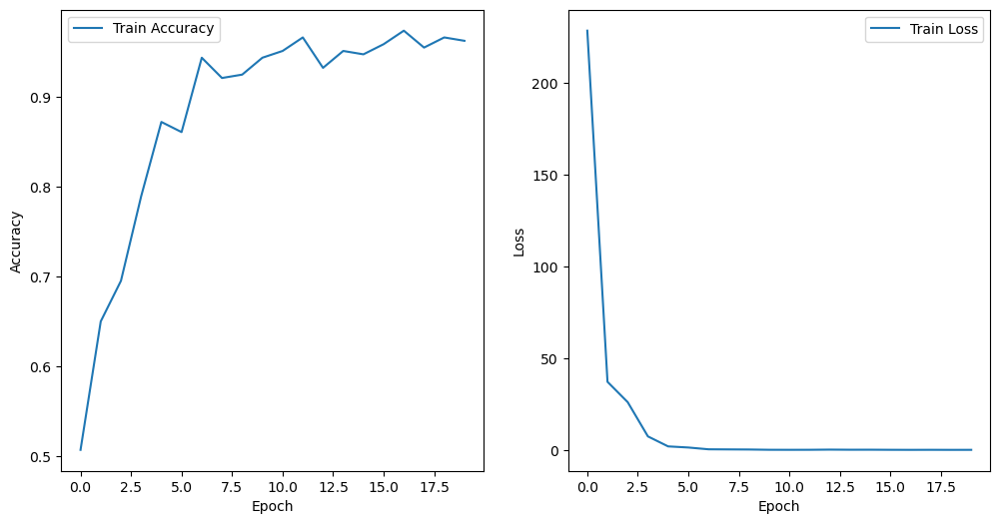

In [2]:
import os
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.layers import Flatten, Dense, Dropout
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from scipy.ndimage import zoom

# Function to load and preprocess NIfTI images
def load_and_preprocess_images_nifti_batch(image_paths, target_size):
    images = []
    for image_path in image_paths:
        img = nib.load(image_path).get_fdata()
        img_resized = zoom(img, target_size / np.array(img.shape), order=1)
        images.append(img_resized)
    return np.array(images)

# Set directories and file paths
image_dir = 'E:/StageEsprit/ADNI_CNN_Transfer_Autoencoder/annual_screening/annual/ADNI/CN,AD,MCI'
excel_path = 'E:/StageEsprit/ADNI_CNN_Transfer_Autoencoder/ADNI1_Annual_2_Yr_3T_8_05_2023 - Copie.xlsx'

# Load labels from Excel file
df = pd.read_excel(excel_path)

# List of allowed image extensions
image_extensions = ['.nii', '.nii.gz']

# List to store image paths
image_paths = []

# Collect image paths from the directory
for file_name in os.listdir(image_dir):
    if any(file_name.lower().endswith(ext) for ext in image_extensions):
        image_path = os.path.join(image_dir, file_name)
        image_paths.append(image_path)

# Target size for image resizing
target_size_reduced = (224, 224, 3)

# Batch size for loading images
batch_size = 5

# Split image paths into batches
image_batches = [image_paths[i:i + batch_size] for i in range(0, len(image_paths), batch_size)]

# Load and preprocess images in batches
images_nifti = []
y_labels = []

for batch_paths in image_batches:
    batch_images = load_and_preprocess_images_nifti_batch(batch_paths, target_size_reduced)
    images_nifti.append(batch_images)

    for image_path in batch_paths:
        image_name = os.path.splitext(os.path.basename(image_path))[0]
        matching_rows = df[df['Subject'].str.contains(image_name)]['Group']
        if len(matching_rows) > 0:
            label = matching_rows.values[0]
            if label == 'CN':
                y_labels.append(0)
            else:
                y_labels.append(1)

images_nifti = np.concatenate(images_nifti, axis=0)
y_labels = np.array(y_labels)

# Split data into train and test sets
train_images, test_images, y_train, y_test = train_test_split(images_nifti, y_labels, test_size=0.3, random_state=42)

# Build 3D Transfer Learning Model (VGG16)
input_shape = target_size_reduced
base_model = tf.keras.applications.VGG16(include_top=False, weights='imagenet', input_shape=input_shape)

for layer in base_model.layers:
    layer.trainable = False

x = Flatten()(base_model.output)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
output_layer = Dense(1, activation='sigmoid')(x)

transfer_model = tf.keras.Model(inputs=base_model.input, outputs=output_layer)

transfer_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                       loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
history = transfer_model.fit(train_images, y_train, batch_size=32, epochs=20, shuffle=True)

# Evaluate the model on test data
y_pred = transfer_model.predict(test_images)
y_pred = (y_pred > 0.5).astype(int).flatten()

# Calculate evaluation metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("Confusion Matrix:")
print(conf_matrix)

# Plot accuracy and loss curves
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()


import math

# Nouvelles dimensions pour l'affichage des images
display_width = 8
display_height = 10

# Calcul du nombre de colonnes en fonction du nombre d'images et des dimensions d'affichage
#num_cols = math.ceil(n / num_rows)
num_cols = 8

num_rows = 15

n = len(test_images)
# Création de la grille pour afficher les images
fig, axes = plt.subplots(num_rows, num_cols, figsize=(display_width * num_cols, display_height * num_rows))

for i, ax in enumerate(axes.flat):
    if i < n:
        ax.imshow(test_images[i][:, :, test_images[i].shape[2] // 2], cmap='gray')  # Sélection de la coupe médiane
        ax.set_title(f"Prédiction : {'Alzheimer' if y_pred[i] == 1 else 'Non-Alzheimer'}", fontsize=40)
        ax.axis('off')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

## IV.2) Classification Multiclasse

Epoch 1/50
9/9 [==============================] - 32s 3s/step - loss: 2.2838 - accuracy: 0.4173
Epoch 2/50
9/9 [==============================] - 41s 4s/step - loss: 1.1558 - accuracy: 0.5376
Epoch 3/50
9/9 [==============================] - 39s 4s/step - loss: 0.8879 - accuracy: 0.5714
Epoch 4/50
9/9 [==============================] - 41s 4s/step - loss: 0.8571 - accuracy: 0.6165
Epoch 5/50
9/9 [==============================] - 40s 4s/step - loss: 0.7718 - accuracy: 0.6617
Epoch 6/50
9/9 [==============================] - 39s 4s/step - loss: 0.6985 - accuracy: 0.7256
Epoch 7/50
9/9 [==============================] - 44s 5s/step - loss: 0.6209 - accuracy: 0.7594
Epoch 8/50
9/9 [==============================] - 46s 5s/step - loss: 0.5766 - accuracy: 0.7744
Epoch 9/50
9/9 [==============================] - 46s 5s/step - loss: 0.4819 - accuracy: 0.8496
Epoch 10/50
9/9 [==============================] - 45s 5s/step - loss: 0.3838 - accuracy: 0.9135
Epoch 11/50
9/9 [======================

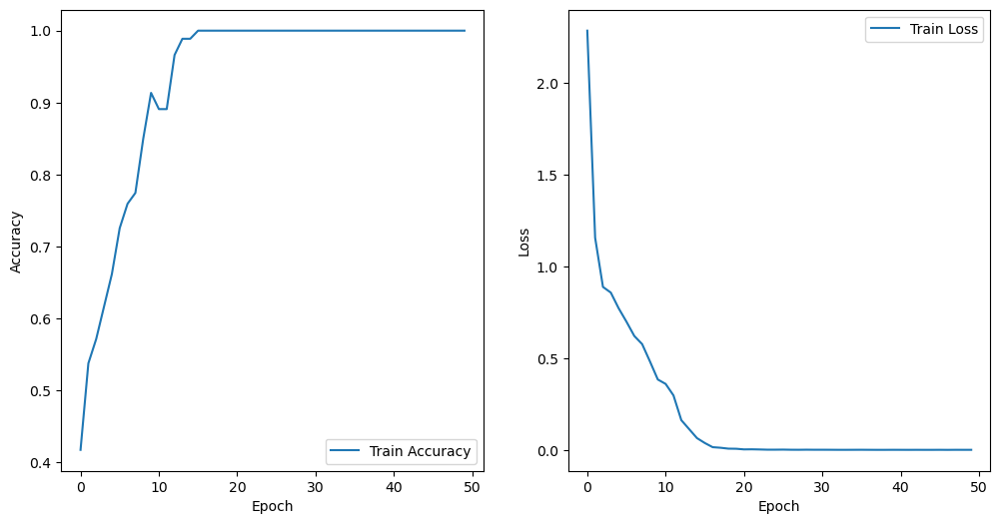

In [2]:
import os
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.layers import Flatten, Dense, Dropout
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
from scipy.ndimage import zoom
from tensorflow.keras.layers import Flatten, Dense, Dropout, LayerNormalization


# Function to load and preprocess NIfTI images
def load_and_preprocess_images_nifti_batch(image_paths, target_size):
    images = []
    for image_path in image_paths:
        img = nib.load(image_path).get_fdata()
        img_resized = zoom(img, target_size / np.array(img.shape), order=1)
        images.append(img_resized)
    return np.array(images)

# Set directories and file paths
image_dir = 'E:/StageEsprit/ADNI_CNN_Transfer_Autoencoder/annual_screening/annual/ADNI/CN,AD,MCI'
excel_path = 'E:/StageEsprit/ADNI_CNN_Transfer_Autoencoder/ADNI1_Annual_2_Yr_3T_8_05_2023 - Copie.xlsx'

# Load labels from Excel file
df = pd.read_excel(excel_path)

# List of allowed image extensions
image_extensions = ['.nii', '.nii.gz']

# List to store image paths
image_paths = []

# Collect image paths from the directory
for file_name in os.listdir(image_dir):
    if any(file_name.lower().endswith(ext) for ext in image_extensions):
        image_path = os.path.join(image_dir, file_name)
        image_paths.append(image_path)

# Target size for image resizing
target_size_reduced = (224, 224, 3)

# Batch size for loading images
batch_size = 5

# Split image paths into batches
image_batches = [image_paths[i:i + batch_size] for i in range(0, len(image_paths), batch_size)]


# Load and preprocess images in batches
images_nifti = []
y_labels = []

for batch_paths in image_batches:
    batch_images = load_and_preprocess_images_nifti_batch(batch_paths, target_size_reduced)
    images_nifti.append(batch_images)

    for image_path in batch_paths:
        image_name = os.path.splitext(os.path.basename(image_path))[0]
        matching_rows = df[df['Subject'].str.contains(image_name)]['Group']
        if len(matching_rows) > 0:
            label = matching_rows.values[0]
            if label == 'CN':
                y_labels.append(0)
            elif label == 'AD':
                y_labels.append(1)
            else:  # Assuming 'MCI' as the third class
                y_labels.append(2)

images_nifti = np.concatenate(images_nifti, axis=0)
y_labels = np.array(y_labels)

# Convert labels to one-hot encoding
y_labels_one_hot = tf.keras.utils.to_categorical(y_labels, num_classes=3)

# Split data into train and test sets
train_images, test_images, y_train, y_test = train_test_split(images_nifti, y_labels_one_hot, test_size=0.3, random_state=42)

# Build 3D Transfer Learning Model (VGG16) for multiclass classification with regularization
input_shape = target_size_reduced
base_model = tf.keras.applications.VGG16(include_top=False, weights='imagenet', input_shape=input_shape)

for layer in base_model.layers:
    layer.trainable = False

x = Flatten()(base_model.output)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
x = LayerNormalization()(x)  # Add layer normalization for regularization
output_layer = Dense(3, activation='softmax')(x)  # Using softmax for multiclass classification

transfer_model = tf.keras.Model(inputs=base_model.input, outputs=output_layer)

transfer_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                       loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
history = transfer_model.fit(train_images, y_train, batch_size=32, epochs=50, shuffle=True)

# Evaluate the model on test data
y_pred_probs = transfer_model.predict(test_images)
y_pred_classes = np.argmax(y_pred_probs, axis=1)

# Calculate evaluation metrics
accuracy = accuracy_score(np.argmax(y_test, axis=1), y_pred_classes)
precision = precision_score(np.argmax(y_test, axis=1), y_pred_classes, average='weighted')
recall = recall_score(np.argmax(y_test, axis=1), y_pred_classes, average='weighted')
f1 = f1_score(np.argmax(y_test, axis=1), y_pred_classes, average='weighted')
conf_matrix = confusion_matrix(np.argmax(y_test, axis=1), y_pred_classes)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("Confusion Matrix:")
print(conf_matrix)

# Plot accuracy and loss curves
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

In [5]:
import math

# Nouvelles dimensions pour l'affichage des images
display_width = 8
display_height = 10

# Calcul du nombre de colonnes en fonction du nombre d'images et des dimensions d'affichage
num_cols = 8
num_rows = math.ceil(len(test_images) / num_cols)

# Création de la grille pour afficher les images
fig, axes = plt.subplots(num_rows, num_cols, figsize=(display_width * num_cols, display_height * num_rows))

for i, ax in enumerate(axes.flat):
    if i < len(test_images):
        ax.imshow(test_images[i][:, :, test_images[i].shape[2] // 2], cmap='gray')  # Sélection de la coupe médiane
        
        pred_label = y_pred_classes[i]
        if pred_label == 0:
            pred_class = 'Non Alzheimer(CN)'
        elif pred_label == 1:
            pred_class = 'Alzheimer (AD)'
        else:
            pred_class = 'Alzheimer (MCI)'
        
        ax.set_title(f"Prédiction : {pred_class}", fontsize=35)
        ax.axis('off')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()
